# Generating Images of Cats and Dogs -- Group 35 
## Conditional GAN
Gustav Lahti (lahtig@student.chalmers.se) and Agnes Mårdh (agnesma@student.chalmers.se) 

## Imports
Importing all the necessary libraries and other useful initialisations.

In [1]:
import os

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import torchvision.transforms as transforms
import torchvision.models as models
import torchvision.utils as vutils

import matplotlib.animation as animation
from IPython.display import HTML

import numpy as np

import matplotlib.pyplot as plt

# Just for benchmarking
import time

%matplotlib inline

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

## Defining various hyperparameters

In [2]:
# Root for images
dataroot = "train"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
# 15 epochs ~ 10 minutes
num_epochs = 300

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

## Initializing DataSet and DataLoader
We are using the same folder structure as for home assignment 1.

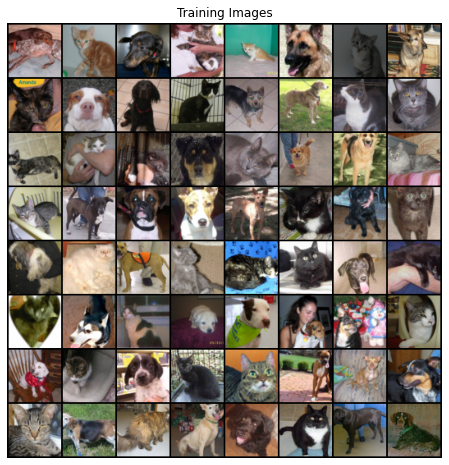

In [3]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [4]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator

In [5]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        
        self.label_emb = nn.Embedding(2, 2)
        
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz + 2, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input, labels):
        c = self.label_emb(labels).view(input.shape[0], 2, 1, 1)
        input = torch.cat([input, c], 1)
        return self.main(input)

In [6]:
# Create the generator
netG = Generator(ngpu).to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (label_emb): Embedding(2, 2)
  (main): Sequential(
    (0): ConvTranspose2d(102, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias

## Discriminator

In [7]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        
        self.in_shape = (64,64,3)
        
        self.embedder = nn.Sequential(
            nn.Embedding(2,2),
            nn.Linear(2, self.in_shape[0] * self.in_shape[1])
        )
        
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc + 1, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input, labels):
        #print(input.shape)
        c = self.embedder(labels)
        #print(c.shape)
        c = c.view(input.shape[0], 1, self.in_shape[0], self.in_shape[1])
        #print(c.shape)
        input = torch.cat([input, c], 1)
        #print(input.shape)
        #print("Wohoo!")
        return self.main(input)

In [8]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (embedder): Sequential(
    (0): Embedding(2, 2)
    (1): Linear(in_features=2, out_features=4096, bias=True)
  )
  (main): Sequential(
    (0): Conv2d(4, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Co

## Setup for training

In [9]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)
fixed_fake_labels = torch.randint(0, 2, (64, 1), device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training loop

In [10]:
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")

# Reference time point for how long the training takes
start_time = time.perf_counter()

# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, (data, real_labels) in enumerate(dataloader, 0):

        real_labels = real_labels.to(device)
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data.to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu, real_labels).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        
        ### OUR BOIII
        fake_labels = torch.randint(0,2,(b_size,)).to(device)
        ### END BOIII
        
        # Generate fake image batch with G
        fake = netG(noise, fake_labels)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach(), fake_labels).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake, fake_labels).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise, fixed_fake_labels).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
# Calculate and display the amount of time the training took
elapsed_time = time.perf_counter() - start_time
print("Training was done in {:.0f}h {:02.0f}m {:.3f}s".format(elapsed_time // 3600, 
                                                              elapsed_time % 3600 // 60, 
                                                              elapsed_time % 60))

Starting Training Loop...
[0/300][0/184]	Loss_D: 1.7090	Loss_G: 14.0374	D(x): 0.5616	D(G(z)): 0.6013 / 0.0003
[0/300][50/184]	Loss_D: 0.4747	Loss_G: 5.7758	D(x): 0.8008	D(G(z)): 0.0139 / 0.0102
[0/300][100/184]	Loss_D: 0.5888	Loss_G: 5.4279	D(x): 0.8672	D(G(z)): 0.3210 / 0.0064
[0/300][150/184]	Loss_D: 0.4106	Loss_G: 4.4268	D(x): 0.8358	D(G(z)): 0.1084 / 0.0177
[1/300][0/184]	Loss_D: 0.3040	Loss_G: 6.5944	D(x): 0.8371	D(G(z)): 0.0123 / 0.0051
[1/300][50/184]	Loss_D: 0.6352	Loss_G: 6.0443	D(x): 0.9294	D(G(z)): 0.3633 / 0.0047
[1/300][100/184]	Loss_D: 0.7585	Loss_G: 3.3187	D(x): 0.6396	D(G(z)): 0.1257 / 0.0707
[1/300][150/184]	Loss_D: 0.3788	Loss_G: 3.1522	D(x): 0.7911	D(G(z)): 0.0764 / 0.0629
[2/300][0/184]	Loss_D: 0.8918	Loss_G: 6.0191	D(x): 0.8663	D(G(z)): 0.4473 / 0.0055
[2/300][50/184]	Loss_D: 0.4717	Loss_G: 4.4360	D(x): 0.6932	D(G(z)): 0.0093 / 0.0206
[2/300][100/184]	Loss_D: 1.1936	Loss_G: 4.8670	D(x): 0.7326	D(G(z)): 0.4806 / 0.0179
[2/300][150/184]	Loss_D: 0.4177	Loss_G: 4.7746	

[24/300][50/184]	Loss_D: 0.8661	Loss_G: 4.0338	D(x): 0.9186	D(G(z)): 0.4820 / 0.0259
[24/300][100/184]	Loss_D: 0.6041	Loss_G: 2.6141	D(x): 0.6327	D(G(z)): 0.0602 / 0.1036
[24/300][150/184]	Loss_D: 0.3437	Loss_G: 2.9650	D(x): 0.8263	D(G(z)): 0.1172 / 0.0801
[25/300][0/184]	Loss_D: 1.1270	Loss_G: 5.0207	D(x): 0.9746	D(G(z)): 0.5956 / 0.0109
[25/300][50/184]	Loss_D: 0.9215	Loss_G: 1.0394	D(x): 0.4989	D(G(z)): 0.0841 / 0.4185
[25/300][100/184]	Loss_D: 0.4830	Loss_G: 3.5980	D(x): 0.8871	D(G(z)): 0.2716 / 0.0380
[25/300][150/184]	Loss_D: 0.5699	Loss_G: 1.5040	D(x): 0.6768	D(G(z)): 0.1067 / 0.3019
[26/300][0/184]	Loss_D: 0.4228	Loss_G: 2.2768	D(x): 0.7586	D(G(z)): 0.0988 / 0.1424
[26/300][50/184]	Loss_D: 0.5194	Loss_G: 3.3528	D(x): 0.8548	D(G(z)): 0.2674 / 0.0500
[26/300][100/184]	Loss_D: 0.6736	Loss_G: 1.2681	D(x): 0.6231	D(G(z)): 0.1144 / 0.3392
[26/300][150/184]	Loss_D: 1.5123	Loss_G: 0.3168	D(x): 0.3165	D(G(z)): 0.0101 / 0.7818
[27/300][0/184]	Loss_D: 0.6981	Loss_G: 4.1791	D(x): 0.9390	D(

[48/300][100/184]	Loss_D: 0.4260	Loss_G: 2.0360	D(x): 0.7433	D(G(z)): 0.0820 / 0.1742
[48/300][150/184]	Loss_D: 0.3744	Loss_G: 2.2382	D(x): 0.8288	D(G(z)): 0.1453 / 0.1353
[49/300][0/184]	Loss_D: 1.6696	Loss_G: 8.2489	D(x): 0.9821	D(G(z)): 0.7521 / 0.0005
[49/300][50/184]	Loss_D: 0.4278	Loss_G: 3.4410	D(x): 0.8814	D(G(z)): 0.2283 / 0.0442
[49/300][100/184]	Loss_D: 0.3347	Loss_G: 2.6791	D(x): 0.8645	D(G(z)): 0.1503 / 0.0889
[49/300][150/184]	Loss_D: 0.4060	Loss_G: 2.1782	D(x): 0.7520	D(G(z)): 0.0752 / 0.1588
[50/300][0/184]	Loss_D: 0.3314	Loss_G: 2.8240	D(x): 0.8273	D(G(z)): 0.1089 / 0.0862
[50/300][50/184]	Loss_D: 0.3503	Loss_G: 2.9803	D(x): 0.9003	D(G(z)): 0.1964 / 0.0694
[50/300][100/184]	Loss_D: 0.5161	Loss_G: 2.1021	D(x): 0.7034	D(G(z)): 0.1066 / 0.1834
[50/300][150/184]	Loss_D: 0.6182	Loss_G: 2.9920	D(x): 0.7559	D(G(z)): 0.2112 / 0.0775
[51/300][0/184]	Loss_D: 0.5209	Loss_G: 3.8034	D(x): 0.9385	D(G(z)): 0.3259 / 0.0300
[51/300][50/184]	Loss_D: 0.3477	Loss_G: 3.4049	D(x): 0.9299	D(

[72/300][150/184]	Loss_D: 2.3438	Loss_G: 1.0545	D(x): 0.4213	D(G(z)): 0.3795 / 0.5193
[73/300][0/184]	Loss_D: 0.9364	Loss_G: 2.3064	D(x): 0.6227	D(G(z)): 0.1652 / 0.1694
[73/300][50/184]	Loss_D: 0.3367	Loss_G: 3.9585	D(x): 0.8949	D(G(z)): 0.1584 / 0.0303
[73/300][100/184]	Loss_D: 0.3337	Loss_G: 3.1606	D(x): 0.8072	D(G(z)): 0.0885 / 0.0606
[73/300][150/184]	Loss_D: 0.3443	Loss_G: 2.4210	D(x): 0.7676	D(G(z)): 0.0474 / 0.1396
[74/300][0/184]	Loss_D: 0.2383	Loss_G: 3.8738	D(x): 0.9504	D(G(z)): 0.1509 / 0.0344
[74/300][50/184]	Loss_D: 0.2298	Loss_G: 3.8052	D(x): 0.9401	D(G(z)): 0.1401 / 0.0337
[74/300][100/184]	Loss_D: 0.1710	Loss_G: 3.9895	D(x): 0.9640	D(G(z)): 0.1167 / 0.0288
[74/300][150/184]	Loss_D: 0.1841	Loss_G: 3.1079	D(x): 0.8928	D(G(z)): 0.0606 / 0.0647
[75/300][0/184]	Loss_D: 0.1737	Loss_G: 3.3201	D(x): 0.8747	D(G(z)): 0.0320 / 0.0573
[75/300][50/184]	Loss_D: 0.1310	Loss_G: 3.7881	D(x): 0.9767	D(G(z)): 0.0963 / 0.0334
[75/300][100/184]	Loss_D: 0.1909	Loss_G: 3.0178	D(x): 0.8782	D(

[97/300][0/184]	Loss_D: 0.0571	Loss_G: 4.5897	D(x): 0.9869	D(G(z)): 0.0416 / 0.0183
[97/300][50/184]	Loss_D: 0.1165	Loss_G: 4.7423	D(x): 0.9570	D(G(z)): 0.0618 / 0.0159
[97/300][100/184]	Loss_D: 0.1062	Loss_G: 3.3343	D(x): 0.9569	D(G(z)): 0.0573 / 0.0589
[97/300][150/184]	Loss_D: 0.1565	Loss_G: 3.3582	D(x): 0.8897	D(G(z)): 0.0319 / 0.0705
[98/300][0/184]	Loss_D: 0.0620	Loss_G: 5.0293	D(x): 0.9545	D(G(z)): 0.0141 / 0.0145
[98/300][50/184]	Loss_D: 0.1322	Loss_G: 3.5515	D(x): 0.9192	D(G(z)): 0.0414 / 0.0491
[98/300][100/184]	Loss_D: 0.1696	Loss_G: 2.8163	D(x): 0.8747	D(G(z)): 0.0211 / 0.1076
[98/300][150/184]	Loss_D: 0.6493	Loss_G: 4.3949	D(x): 0.8066	D(G(z)): 0.2172 / 0.0246
[99/300][0/184]	Loss_D: 0.3127	Loss_G: 3.9298	D(x): 0.8866	D(G(z)): 0.1367 / 0.0349
[99/300][50/184]	Loss_D: 0.2007	Loss_G: 3.5901	D(x): 0.8714	D(G(z)): 0.0423 / 0.0486
[99/300][100/184]	Loss_D: 0.2247	Loss_G: 3.8348	D(x): 0.9311	D(G(z)): 0.1255 / 0.0337
[99/300][150/184]	Loss_D: 0.1358	Loss_G: 3.9709	D(x): 0.9237	D(

[121/300][0/184]	Loss_D: 0.0703	Loss_G: 4.7610	D(x): 0.9460	D(G(z)): 0.0131 / 0.0181
[121/300][50/184]	Loss_D: 0.0838	Loss_G: 4.9357	D(x): 0.9902	D(G(z)): 0.0673 / 0.0124
[121/300][100/184]	Loss_D: 0.0926	Loss_G: 4.1160	D(x): 0.9576	D(G(z)): 0.0458 / 0.0268
[121/300][150/184]	Loss_D: 0.0839	Loss_G: 4.0962	D(x): 0.9535	D(G(z)): 0.0333 / 0.0306
[122/300][0/184]	Loss_D: 2.3302	Loss_G: 1.0258	D(x): 0.3729	D(G(z)): 0.2952 / 0.5956
[122/300][50/184]	Loss_D: 1.6026	Loss_G: 1.1995	D(x): 0.5055	D(G(z)): 0.4396 / 0.3611
[122/300][100/184]	Loss_D: 1.5556	Loss_G: 1.0333	D(x): 0.4203	D(G(z)): 0.2970 / 0.4164
[122/300][150/184]	Loss_D: 0.9966	Loss_G: 3.1422	D(x): 0.6799	D(G(z)): 0.2800 / 0.0763
[123/300][0/184]	Loss_D: 2.7382	Loss_G: 6.4878	D(x): 0.9925	D(G(z)): 0.8352 / 0.0078
[123/300][50/184]	Loss_D: 0.3228	Loss_G: 5.1059	D(x): 0.9505	D(G(z)): 0.1868 / 0.0101
[123/300][100/184]	Loss_D: 0.2069	Loss_G: 3.6673	D(x): 0.8929	D(G(z)): 0.0706 / 0.0452
[123/300][150/184]	Loss_D: 0.1835	Loss_G: 3.3964	D(x

[144/300][150/184]	Loss_D: 0.0857	Loss_G: 4.3352	D(x): 0.9361	D(G(z)): 0.0174 / 0.0257
[145/300][0/184]	Loss_D: 0.0614	Loss_G: 5.0654	D(x): 0.9927	D(G(z)): 0.0484 / 0.0108
[145/300][50/184]	Loss_D: 0.0768	Loss_G: 4.8549	D(x): 0.9666	D(G(z)): 0.0379 / 0.0139
[145/300][100/184]	Loss_D: 0.1079	Loss_G: 5.4863	D(x): 0.9956	D(G(z)): 0.0901 / 0.0061
[145/300][150/184]	Loss_D: 0.0609	Loss_G: 4.5416	D(x): 0.9769	D(G(z)): 0.0346 / 0.0205
[146/300][0/184]	Loss_D: 0.0183	Loss_G: 6.1708	D(x): 0.9904	D(G(z)): 0.0086 / 0.0042
[146/300][50/184]	Loss_D: 0.0384	Loss_G: 4.7630	D(x): 0.9808	D(G(z)): 0.0183 / 0.0168
[146/300][100/184]	Loss_D: 0.0453	Loss_G: 4.9621	D(x): 0.9778	D(G(z)): 0.0218 / 0.0129
[146/300][150/184]	Loss_D: 0.0790	Loss_G: 4.9553	D(x): 0.9855	D(G(z)): 0.0571 / 0.0112
[147/300][0/184]	Loss_D: 0.0588	Loss_G: 5.1240	D(x): 0.9843	D(G(z)): 0.0403 / 0.0099
[147/300][50/184]	Loss_D: 0.0458	Loss_G: 5.0897	D(x): 0.9825	D(G(z)): 0.0255 / 0.0112
[147/300][100/184]	Loss_D: 0.0576	Loss_G: 4.7583	D(x

[168/300][100/184]	Loss_D: 0.0428	Loss_G: 4.7392	D(x): 0.9811	D(G(z)): 0.0228 / 0.0180
[168/300][150/184]	Loss_D: 0.0443	Loss_G: 5.3922	D(x): 0.9811	D(G(z)): 0.0242 / 0.0083
[169/300][0/184]	Loss_D: 0.0543	Loss_G: 5.0689	D(x): 0.9968	D(G(z)): 0.0477 / 0.0104
[169/300][50/184]	Loss_D: 0.0519	Loss_G: 4.7143	D(x): 0.9803	D(G(z)): 0.0302 / 0.0158
[169/300][100/184]	Loss_D: 0.0577	Loss_G: 5.3091	D(x): 0.9801	D(G(z)): 0.0355 / 0.0092
[169/300][150/184]	Loss_D: 0.0619	Loss_G: 5.4822	D(x): 0.9908	D(G(z)): 0.0493 / 0.0067
[170/300][0/184]	Loss_D: 0.0232	Loss_G: 5.3240	D(x): 0.9931	D(G(z)): 0.0158 / 0.0091
[170/300][50/184]	Loss_D: 0.0458	Loss_G: 5.3323	D(x): 0.9685	D(G(z)): 0.0130 / 0.0124
[170/300][100/184]	Loss_D: 0.0430	Loss_G: 5.5362	D(x): 0.9872	D(G(z)): 0.0271 / 0.0079
[170/300][150/184]	Loss_D: 1.8201	Loss_G: 1.4574	D(x): 0.6173	D(G(z)): 0.5659 / 0.3358
[171/300][0/184]	Loss_D: 1.4135	Loss_G: 1.4289	D(x): 0.6043	D(G(z)): 0.4624 / 0.2987
[171/300][50/184]	Loss_D: 1.2415	Loss_G: 1.3898	D(x

[192/300][50/184]	Loss_D: 0.0392	Loss_G: 6.0515	D(x): 0.9786	D(G(z)): 0.0168 / 0.0050
[192/300][100/184]	Loss_D: 0.0547	Loss_G: 4.7594	D(x): 0.9575	D(G(z)): 0.0100 / 0.0215
[192/300][150/184]	Loss_D: 0.0346	Loss_G: 5.0915	D(x): 0.9824	D(G(z)): 0.0163 / 0.0134
[193/300][0/184]	Loss_D: 0.0388	Loss_G: 5.1398	D(x): 0.9951	D(G(z)): 0.0315 / 0.0100
[193/300][50/184]	Loss_D: 0.0183	Loss_G: 7.1907	D(x): 0.9858	D(G(z)): 0.0039 / 0.0020
[193/300][100/184]	Loss_D: 0.0343	Loss_G: 5.6608	D(x): 0.9923	D(G(z)): 0.0255 / 0.0069
[193/300][150/184]	Loss_D: 0.0362	Loss_G: 5.4904	D(x): 0.9876	D(G(z)): 0.0219 / 0.0081
[194/300][0/184]	Loss_D: 0.0367	Loss_G: 5.2154	D(x): 0.9765	D(G(z)): 0.0123 / 0.0147
[194/300][50/184]	Loss_D: 0.0288	Loss_G: 6.3250	D(x): 0.9943	D(G(z)): 0.0214 / 0.0043
[194/300][100/184]	Loss_D: 0.0299	Loss_G: 5.8382	D(x): 0.9827	D(G(z)): 0.0119 / 0.0067
[194/300][150/184]	Loss_D: 0.0182	Loss_G: 6.3782	D(x): 0.9946	D(G(z)): 0.0121 / 0.0045
[195/300][0/184]	Loss_D: 0.0416	Loss_G: 6.1832	D(x

[216/300][0/184]	Loss_D: 0.0251	Loss_G: 5.7780	D(x): 0.9946	D(G(z)): 0.0189 / 0.0062
[216/300][50/184]	Loss_D: 0.0148	Loss_G: 6.4589	D(x): 0.9978	D(G(z)): 0.0122 / 0.0041
[216/300][100/184]	Loss_D: 0.0152	Loss_G: 6.4470	D(x): 0.9977	D(G(z)): 0.0125 / 0.0042
[216/300][150/184]	Loss_D: 0.0518	Loss_G: 4.7661	D(x): 0.9586	D(G(z)): 0.0085 / 0.0218
[217/300][0/184]	Loss_D: 1.3049	Loss_G: 1.1599	D(x): 0.5426	D(G(z)): 0.3659 / 0.3729
[217/300][50/184]	Loss_D: 1.2220	Loss_G: 1.5876	D(x): 0.6568	D(G(z)): 0.4165 / 0.2668
[217/300][100/184]	Loss_D: 0.4782	Loss_G: 4.5679	D(x): 0.8100	D(G(z)): 0.1190 / 0.0320
[217/300][150/184]	Loss_D: 0.2590	Loss_G: 6.7520	D(x): 0.9710	D(G(z)): 0.1508 / 0.0031
[218/300][0/184]	Loss_D: 0.1052	Loss_G: 5.7376	D(x): 0.9272	D(G(z)): 0.0114 / 0.0125
[218/300][50/184]	Loss_D: 0.0746	Loss_G: 5.1872	D(x): 0.9563	D(G(z)): 0.0262 / 0.0141
[218/300][100/184]	Loss_D: 0.1039	Loss_G: 6.1096	D(x): 0.9966	D(G(z)): 0.0855 / 0.0040
[218/300][150/184]	Loss_D: 0.0799	Loss_G: 4.2955	D(x

[239/300][150/184]	Loss_D: 0.0130	Loss_G: 6.1497	D(x): 0.9951	D(G(z)): 0.0080 / 0.0057
[240/300][0/184]	Loss_D: 0.0284	Loss_G: 5.6963	D(x): 0.9934	D(G(z)): 0.0205 / 0.0092
[240/300][50/184]	Loss_D: 0.0289	Loss_G: 5.7373	D(x): 0.9843	D(G(z)): 0.0127 / 0.0092
[240/300][100/184]	Loss_D: 0.0268	Loss_G: 5.6899	D(x): 0.9850	D(G(z)): 0.0113 / 0.0101
[240/300][150/184]	Loss_D: 0.0167	Loss_G: 6.4117	D(x): 0.9942	D(G(z)): 0.0106 / 0.0048
[241/300][0/184]	Loss_D: 0.0143	Loss_G: 6.0732	D(x): 0.9956	D(G(z)): 0.0097 / 0.0057
[241/300][50/184]	Loss_D: 0.0206	Loss_G: 5.7558	D(x): 0.9887	D(G(z)): 0.0090 / 0.0073
[241/300][100/184]	Loss_D: 0.0305	Loss_G: 5.9577	D(x): 0.9781	D(G(z)): 0.0080 / 0.0068
[241/300][150/184]	Loss_D: 0.0192	Loss_G: 6.0001	D(x): 0.9928	D(G(z)): 0.0117 / 0.0062
[242/300][0/184]	Loss_D: 0.0127	Loss_G: 6.1383	D(x): 0.9948	D(G(z)): 0.0074 / 0.0061
[242/300][50/184]	Loss_D: 0.0310	Loss_G: 5.9848	D(x): 0.9902	D(G(z)): 0.0203 / 0.0063
[242/300][100/184]	Loss_D: 0.0185	Loss_G: 5.9402	D(x

[263/300][100/184]	Loss_D: 1.1114	Loss_G: 2.1791	D(x): 0.6131	D(G(z)): 0.2279 / 0.2258
[263/300][150/184]	Loss_D: 1.2131	Loss_G: 2.4311	D(x): 0.8150	D(G(z)): 0.5035 / 0.1552
[264/300][0/184]	Loss_D: 0.9131	Loss_G: 4.0192	D(x): 0.8809	D(G(z)): 0.3630 / 0.0441
[264/300][50/184]	Loss_D: 0.3584	Loss_G: 5.9151	D(x): 0.9155	D(G(z)): 0.1317 / 0.0101
[264/300][100/184]	Loss_D: 0.3888	Loss_G: 8.9964	D(x): 0.9869	D(G(z)): 0.2323 / 0.0003
[264/300][150/184]	Loss_D: 0.0775	Loss_G: 5.5405	D(x): 0.9698	D(G(z)): 0.0398 / 0.0104
[265/300][0/184]	Loss_D: 0.0801	Loss_G: 5.4613	D(x): 0.9623	D(G(z)): 0.0336 / 0.0161
[265/300][50/184]	Loss_D: 0.0836	Loss_G: 4.9574	D(x): 0.9788	D(G(z)): 0.0526 / 0.0171
[265/300][100/184]	Loss_D: 0.0600	Loss_G: 5.8634	D(x): 0.9931	D(G(z)): 0.0448 / 0.0073
[265/300][150/184]	Loss_D: 0.0450	Loss_G: 5.8681	D(x): 0.9859	D(G(z)): 0.0264 / 0.0085
[266/300][0/184]	Loss_D: 0.0605	Loss_G: 5.3647	D(x): 0.9811	D(G(z)): 0.0377 / 0.0115
[266/300][50/184]	Loss_D: 0.0626	Loss_G: 5.9628	D(x

[287/300][50/184]	Loss_D: 0.0261	Loss_G: 6.1429	D(x): 0.9947	D(G(z)): 0.0163 / 0.0057
[287/300][100/184]	Loss_D: 0.0070	Loss_G: 6.9289	D(x): 0.9958	D(G(z)): 0.0028 / 0.0024
[287/300][150/184]	Loss_D: 0.0178	Loss_G: 6.6469	D(x): 0.9970	D(G(z)): 0.0141 / 0.0032
[288/300][0/184]	Loss_D: 0.0160	Loss_G: 6.1831	D(x): 0.9899	D(G(z)): 0.0057 / 0.0053
[288/300][50/184]	Loss_D: 0.0213	Loss_G: 6.2538	D(x): 0.9890	D(G(z)): 0.0098 / 0.0049
[288/300][100/184]	Loss_D: 0.0050	Loss_G: 7.2619	D(x): 0.9972	D(G(z)): 0.0021 / 0.0018
[288/300][150/184]	Loss_D: 0.0208	Loss_G: 6.2781	D(x): 0.9833	D(G(z)): 0.0037 / 0.0059
[289/300][0/184]	Loss_D: 0.0202	Loss_G: 7.2933	D(x): 0.9973	D(G(z)): 0.0166 / 0.0018
[289/300][50/184]	Loss_D: 0.0143	Loss_G: 6.5481	D(x): 0.9961	D(G(z)): 0.0101 / 0.0039
[289/300][100/184]	Loss_D: 0.0220	Loss_G: 6.8195	D(x): 0.9960	D(G(z)): 0.0171 / 0.0031
[289/300][150/184]	Loss_D: 0.0112	Loss_G: 6.3335	D(x): 0.9945	D(G(z)): 0.0055 / 0.0048
[290/300][0/184]	Loss_D: 0.0226	Loss_G: 6.8056	D(x

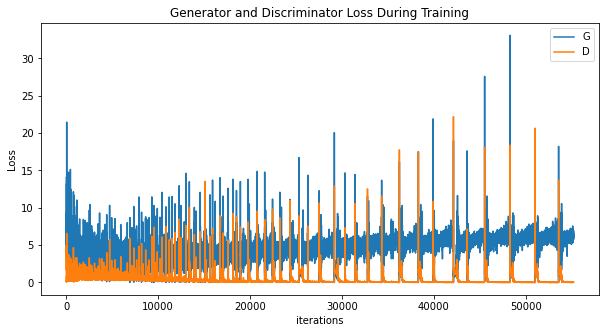

In [11]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

## Timelapse of generator's progress

Animation size has reached 21034117 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


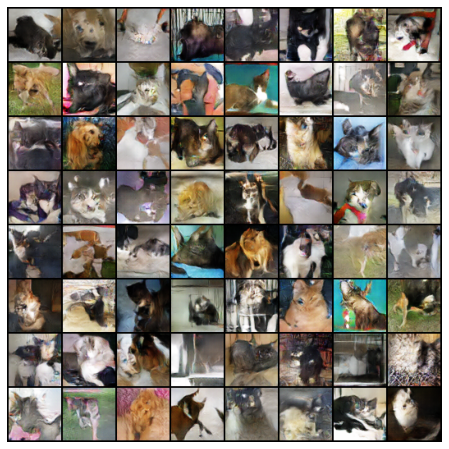

In [12]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

## Compare real and generated images

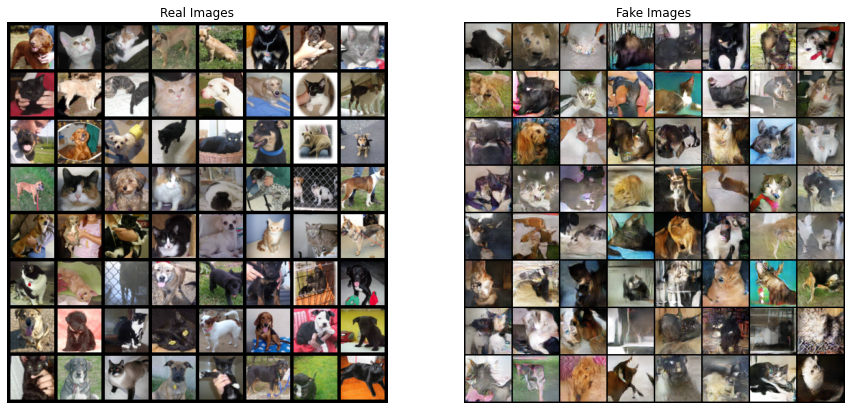

In [13]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

In [15]:
torch.save(netG.state_dict(), "cond_netG")
torch.save(netD.state_dict(), "cond_netD")
torch.save(img_list,          "cond_img_list")